In [1]:
import geopandas

In [2]:
shp_file = geopandas.read_file('./data_raw/fl_2016/fl_2016.shp')

In [29]:
shp_file

,pct,county,countypct,G16PRERTru,G16PREDCli,G16PRELJon,G16PRECCas,G16PREGSte,G16PREIDeL,G16PREoth,G16USSRRub,G16USSDMur,G16USSLSta,G16USSOth,geometry
0,001,DAD,DAD001,277,195,4,0,2,0,5,337,133,3,5,"POLYGON Z ((943790.734 591023.581 0.000, 94364..."
1,010,DAD,DAD010,20,16,0,0,0,0,0,30,6,0,0,"POLYGON Z ((942137.421 562243.019 0.000, 94093..."
2,100,DAD,DAD100,641,2893,66,17,41,16,24,897,2434,50,99,"POLYGON Z ((873353.097 533771.394 0.000, 87420..."
3,101,DAD,DAD101,679,1096,34,0,7,0,18,845,947,14,17,"POLYGON Z ((936263.331 593379.375 0.000, 93560..."
4,102,DAD,DAD102,1100,1596,29,1,4,2,22,1399,1274,16,32,"POLYGON Z ((940693.858 597222.143 0.000, 94069..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5962,4,HOL,HOL 4,1077,105,24,2,2,1,4,1006,127,39,34,"POLYGON Z ((-866918.391 2432253.809 0.000, -86..."
5963,5,HOL,HOL 5,390,30,6,0,0,0,3,354,38,5,21,"POLYGON Z ((-877881.043 2406385.282 0.000, -87..."
5964,6,HOL,HOL 6,1667,126,26,2,3,0,7,1567,153,34,45,"POLYGON Z ((-824547.862 2411437.171 0.000, -82..."
5965,7,HOL,HOL 7,1307,180,26,1,4,7,6,1266,180,33,38,"POLYGON Z ((-848746.355 2379671.775 0.000, -84..."


In [3]:
shp_file.query('county == "ORA"')

,pct,county,countypct,G16PRERTru,G16PREDCli,G16PRELJon,G16PRECCas,G16PREGSte,G16PREIDeL,G16PREoth,G16USSRRub,G16USSDMur,G16USSLSta,G16USSOth,geometry
2435,101,ORA,ORA101,1054,1995,65,3,22,1,27,1274,1702,53,58,"POLYGON Z ((504909.204 1523375.895 0.000, 5049..."
2436,102,ORA,ORA102,794,1174,64,5,12,1,15,909,1052,41,36,"POLYGON Z ((499427.900 1523225.458 0.000, 4994..."
2437,103,ORA,ORA103,850,978,48,1,11,3,26,996,812,35,26,"POLYGON Z ((485063.981 1522998.231 0.000, 4849..."
2438,104,ORA,ORA104,1234,1651,65,7,26,4,24,1396,1414,67,72,"POLYGON Z ((497127.251 1529739.702 0.000, 4971..."
2439,105,ORA,ORA105,405,1287,29,2,10,2,17,473,1167,33,35,"POLYGON Z ((477486.115 1540281.324 0.000, 4774..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2677,630,ORA,ORA630,328,1064,33,1,8,1,10,374,949,31,35,"POLYGON Z ((535312.974 1519374.074 0.000, 5352..."
2678,631,ORA,ORA631,0,6,0,0,0,0,0,0,5,0,0,"POLYGON Z ((535303.344 1522038.159 0.000, 5352..."
2679,632,ORA,ORA632,460,2002,28,5,18,1,13,573,1804,49,53,"POLYGON Z ((528697.934 1513296.086 0.000, 5286..."
2680,633,ORA,ORA633,295,2019,50,2,31,2,17,456,1827,41,32,"POLYGON Z ((528714.463 1508964.541 0.000, 5283..."


<AxesSubplot:>

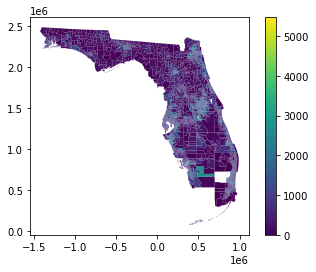

In [30]:
shp_file.plot(column='G16PREDCli', legend=True)

In [5]:
orange = shp_file.query('county == "ORA"')

In [6]:
orange = orange.set_index("countypct")

In [7]:
orange = orange.drop("ORA631")

In [8]:
try:
    del orange["G16PRE_sum"]
except KeyError:
    pass
pres_columns = [col for col in orange.columns if 'G16PRE' in col]
orange.loc[:, "G16PRE_sum"] = orange[pres_columns].sum(axis=1)
orange.loc[:, "G16PRE_dem_frac"] = orange["G16PREDCli"] / (orange["G16PRE_sum"] + 1e-20)
orange.loc[:, "G16PRE_rep_frac"] = orange["G16PRERTru"] / (orange["G16PRE_sum"] + 1e-20)
orange.loc[:, "G16PRE_oth_frac"] = (orange["G16PRE_sum"] - orange["G16PRERTru"] - orange["G16PREDCli"]) / (orange["G16PRE_sum"] + 1e-20)

<AxesSubplot:>

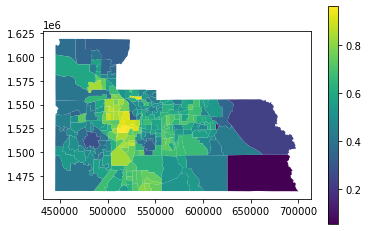

In [9]:
orange.plot(column='G16PRE_dem_frac', legend=True)

In [10]:
orange.to_crs(epsg=4326).tail()

,pct,county,G16PRERTru,G16PREDCli,G16PRELJon,G16PRECCas,G16PREGSte,G16PREIDeL,G16PREoth,G16USSRRub,G16USSDMur,G16USSLSta,G16USSOth,geometry,G16PRE_sum,G16PRE_dem_frac,G16PRE_rep_frac,G16PRE_oth_frac
countypct,,,,,,,,,,,,,,,,,,
ORA629,629,ORA,98,1408,11,3,8,2,5,146,1295,18,32,"POLYGON Z ((-81.38327 28.53523 0.00000, -81.38...",1535,0.917264,0.063844,0.018893
ORA630,630,ORA,328,1064,33,1,8,1,10,374,949,31,35,"POLYGON Z ((-81.37632 28.51291 0.00000, -81.37...",1445,0.736332,0.226990,0.036678
ORA632,632,ORA,460,2002,28,5,18,1,13,573,1804,49,53,"POLYGON Z ((-81.39685 28.49614 0.00000, -81.39...",2527,0.792244,0.182034,0.025722
ORA633,633,ORA,295,2019,50,2,31,2,17,456,1827,41,32,"POLYGON Z ((-81.39675 28.48422 0.00000, -81.39...",2416,0.835679,0.122103,0.042219
ORA634,634,ORA,170,1542,20,2,17,3,12,258,1401,25,37,"MULTIPOLYGON Z (((-81.39670 28.47803 0.00000, ...",1766,0.873160,0.096263,0.030578


In [11]:
import plotly.graph_objects as go

In [12]:
orange[["geometry", "G16PRE_dem_frac"]]

,geometry,G16PRE_dem_frac
countypct,,
ORA101,"POLYGON Z ((504909.204 1523375.895 0.000, 5049...",0.629934
ORA102,"POLYGON Z ((499427.900 1523225.458 0.000, 4994...",0.568523
ORA103,"POLYGON Z ((485063.981 1522998.231 0.000, 4849...",0.510172
ORA104,"POLYGON Z ((497127.251 1529739.702 0.000, 4971...",0.548323
ORA105,"POLYGON Z ((477486.115 1540281.324 0.000, 4774...",0.734589
...,...,...
ORA629,"POLYGON Z ((533106.241 1527496.129 0.000, 5330...",0.917264
ORA630,"POLYGON Z ((535312.974 1519374.074 0.000, 5352...",0.736332
ORA632,"POLYGON Z ((528697.934 1513296.086 0.000, 5286...",0.792244


In [13]:
orange_geojson = orange["geometry"].to_crs(epsg=4326).__geo_interface__

In [14]:
orange_geojson["features"][0]["id"]

'ORA101'

In [15]:
import json

with open("orange_2016_with_geo.json", "w") as f:
    json.dump(orange_geojson, f)


In [16]:
MAPBOX_ACCESSTOKEN = 'pk.eyJ1IjoiZ3Jpc2FpdGlzIiwiYSI6ImNraDhnN3g2bzAyMWkycXIxamR0NXJscmgifQ.vyRCvByr3xNwonFcVco-HA'

In [31]:
data = go.Choroplethmapbox(
    geojson=orange_geojson,
    locations=orange.index,
    z=orange["G16PRE_dem_frac"],
    zmin=0,
    zmax=1,
    marker_line_width=1,
    colorbar=dict(thickness=20, ticklen=3, tickformat='%',outlinewidth=0),
    colorscale=[(0,"red"), (0.5, "white"), (1,"blue")],
    marker_opacity=0.6
)

In [32]:
fig = go.Figure(data)

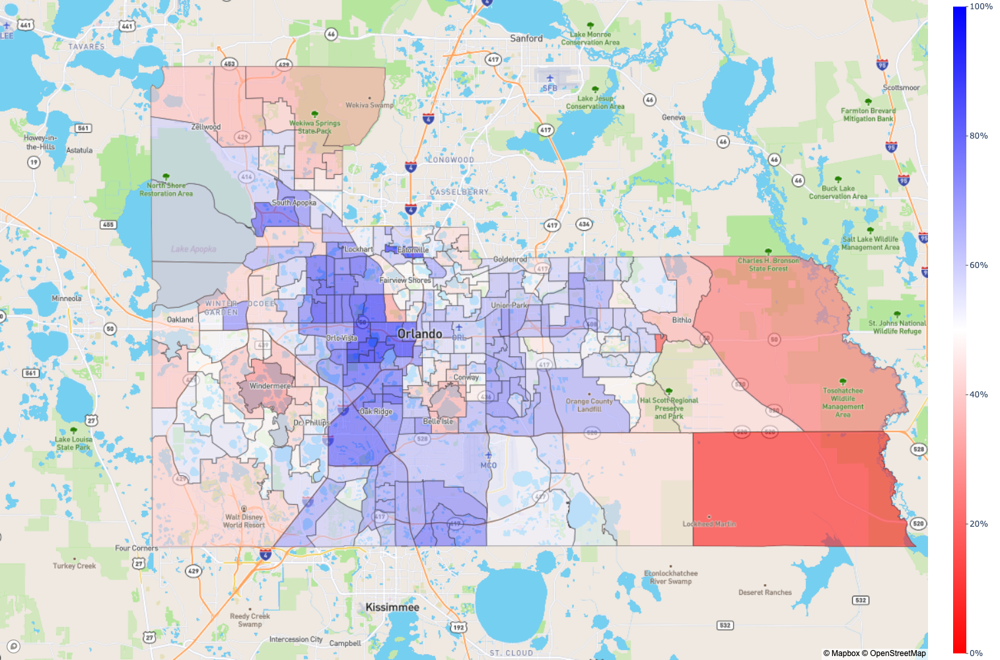

In [34]:
fig.update_layout(
    mapbox_style="streets",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0}
)
fig.show()

# load 2020 data

In [20]:
import pandas as pd

In [21]:
orange_2020 = pd.read_csv('./orange_2020_from_pdf.csv', index_col='countypct')

columns = orange_2020.columns
candidates = [col for col in columns if not ' VOTES' in col]
print(candidates)
orange_2020.loc[:, "votes_valid"] = orange_2020[candidates].sum(axis=1) 
orange_2020.loc[:, "votes_all"] = orange_2020[columns].sum(axis=1) 

orange_2020.rename(columns={"Donald J. Trump": "rep", "Joseph R. Biden": "dem"}, inplace=True)

orange_2020.loc[:, "dem_frac"] = orange_2020["dem"] / (orange_2020["votes_valid"] + 1e-20)
orange_2020.loc[:, "rep_frac"] = orange_2020["rep"] / (orange_2020["votes_valid"] + 1e-20)
orange_2020.loc[:, "oth_frac"] = (orange_2020["votes_valid"] - orange_2020["rep"] - orange_2020["dem"]) / (orange_2020["votes_valid"] + 1e-20)


['Don Blankenship', 'Donald J. Trump', 'Gloria La Riva', 'Howie Hawkins', 'Jo Jorgensen', 'Joseph R. Biden', 'Roque "Rocky" De La Fuente', 'WRITE-IN']


In [22]:
orange_2020.loc["ORA522"]

Don Blankenship                  0.000000
rep                           1220.000000
Gloria La Riva                   0.000000
Howie Hawkins                    2.000000
Jo Jorgensen                    16.000000
dem                           1228.000000
OVER VOTES                       3.000000
Roque "Rocky" De La Fuente       2.000000
UNDER VOTES                     16.000000
WRITE-IN                        13.000000
votes_valid                   2481.000000
votes_all                     2500.000000
dem_frac                         0.494962
rep_frac                         0.491737
oth_frac                         0.013301
Name: ORA522, dtype: float64

In [23]:
orange_2020

,Don Blankenship,rep,Gloria La Riva,Howie Hawkins,Jo Jorgensen,dem,OVER VOTES,"Roque ""Rocky"" De La Fuente",UNDER VOTES,WRITE-IN,votes_valid,votes_all,dem_frac,rep_frac,oth_frac
countypct,,,,,,,,,,,,,,,
ORA101,3,1244,2,6,19,2169,8,1,4,9,3453,3465,0.628149,0.360266,0.011584
ORA102,0,887,2,2,17,1382,2,2,7,7,2299,2308,0.601131,0.385820,0.013049
ORA103,1,1004,0,1,21,1203,2,1,16,8,2239,2257,0.537293,0.448414,0.014292
ORA104,0,1332,5,8,21,1994,7,2,10,10,3372,3389,0.591340,0.395018,0.013642
ORA105,0,555,2,0,13,1328,17,1,7,9,1908,1932,0.696017,0.290881,0.013103
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ORA630,1,378,0,4,12,1219,14,0,4,2,1616,1634,0.754332,0.233911,0.011757
ORA631,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000
ORA632,1,638,4,2,18,2329,26,2,8,5,2999,3033,0.776592,0.212738,0.010670


# merge data

In [24]:
orange_2016_2020 = orange[["G16PRE_dem_frac"]].join(orange_2020[["dem_frac", "votes_valid"]])
orange_2016_2020.rename(columns={"G16PRE_dem_frac": "dem_frac_2016", "dem_frac": "dem_frac_2020", "votes_valid": "votes_valid_2020"}, inplace=True)
orange_2016_2020.loc[:, "dem_frac_change"] = orange_2016_2020["dem_frac_2020"] - orange_2016_2020["dem_frac_2016"]
orange_2016_2020

,dem_frac_2016,dem_frac_2020,votes_valid_2020,dem_frac_change
countypct,,,,
ORA101,0.629934,0.628149,3453,-0.001784
ORA102,0.568523,0.601131,2299,0.032608
ORA103,0.510172,0.537293,2239,0.027121
ORA104,0.548323,0.591340,3372,0.043018
ORA105,0.734589,0.696017,1908,-0.038572
...,...,...,...,...
ORA629,0.917264,0.868563,2039,-0.048701
ORA630,0.736332,0.754332,1616,0.018000
ORA632,0.792244,0.776592,2999,-0.015652


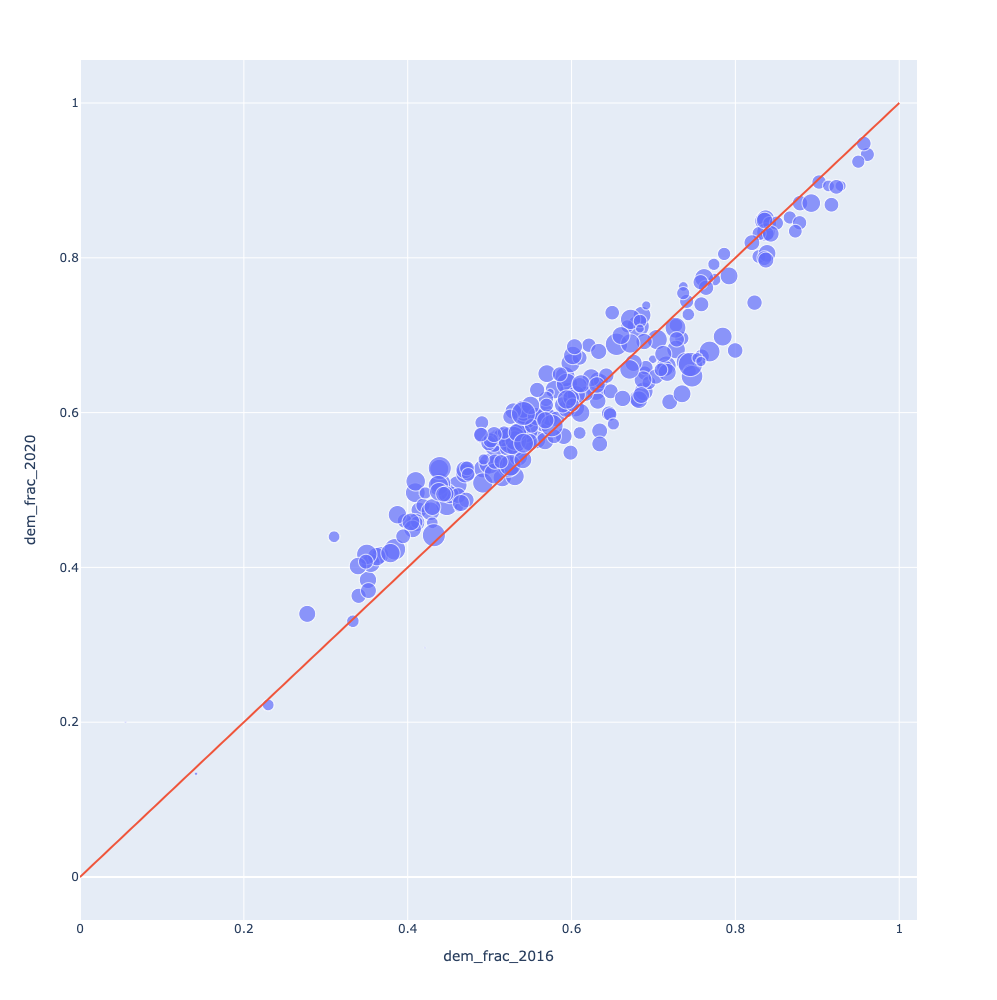

In [25]:
# scatter 1

import plotly.express as px
fig = px.scatter(orange_2016_2020.reset_index(), x="dem_frac_2016", y="dem_frac_2020", size="votes_valid_2020", hover_data=['countypct'])
# fig.add_scatter(x=[0, 1], y=[0, 1], name="no change")
fig.add_trace(
    go.Scatter(
        x=[0, 1],
        y=[0, 1],
        mode="lines",
        showlegend=False
    )
)
fig.update_layout(height=1000)
fig.show()


In [ ]:
orange_2016_2020.loc["ORA522"]

In [26]:
data = go.Choroplethmapbox(
    geojson=orange_geojson,
    locations=orange_2016_2020.index,
    z=orange_2016_2020["dem_frac_2020"],
    zmin=0,
    zmax=1,
    marker_line_width=0,
    colorbar=dict(thickness=20, ticklen=3, tickformat='%',outlinewidth=0),
    colorscale=[
        (0, "red"),
        (0.40, "rgb(255, 200, 200)"),
        (0.5, "white"),
        (0.60, "rgb(200, 200, 255)"),
        (1, "blue")],
    marker_opacity=0.8,
    name="precincts",
)

In [27]:
fig = go.Figure(data)

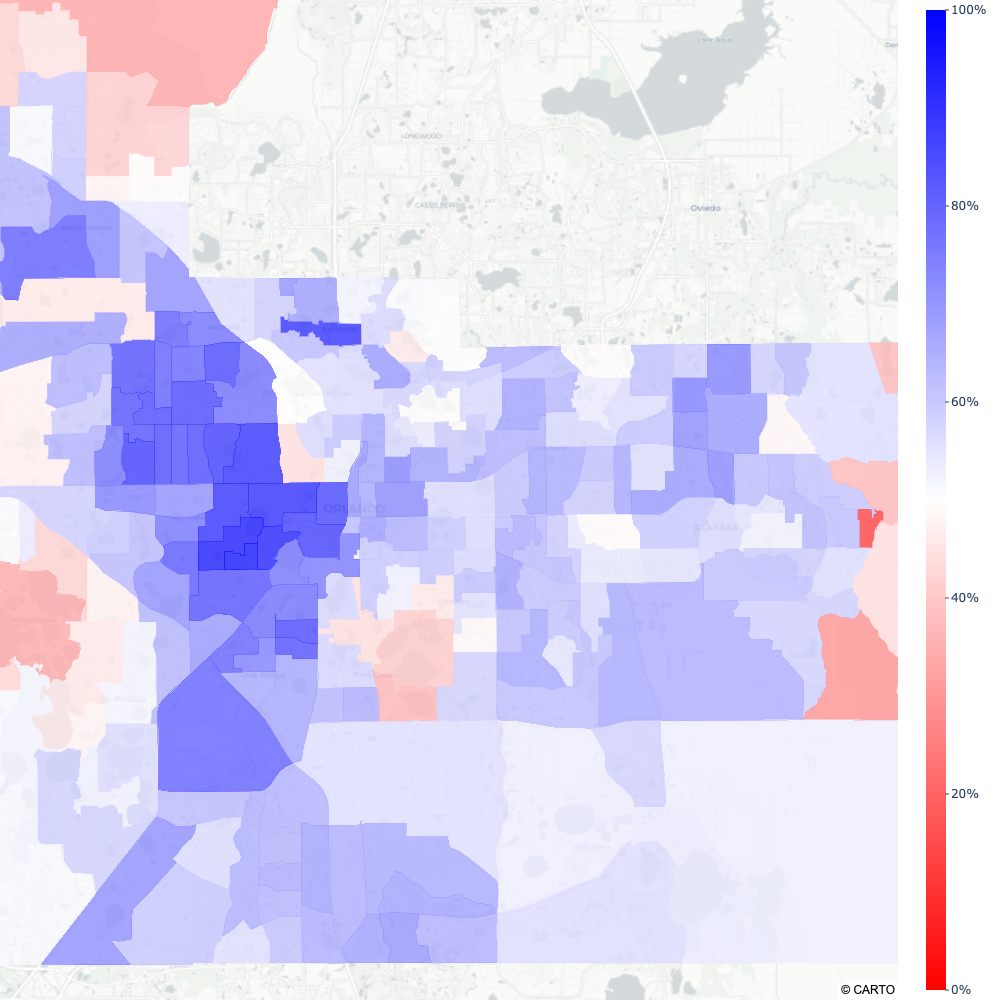

In [28]:
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_accesstoken=MAPBOX_ACCESSTOKEN,
    mapbox_zoom=10.5,
    mapbox_center = {"lat": 28.545556, "lon": -81.333056},  # ORL airport
    autosize=True,
    height=1000,
    margin={"r":0,"t":0,"l":0,"b":0},
)
fig.show()

In [ ]:
fig.write_image(file="./dem_frac_2020.jpg", width=1920, height=1200)